<a href="https://colab.research.google.com/github/nachomadra01/TFG/blob/main/Train_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install atomai

Note: you may need to restart the kernel to use updated packages.


In [ ]:
import numpy as np
import matplotlib.pyplot as plt

#Función deconvolución
def conv(Exp):
    import scipy.signal
    A = [[0.003, 0.013, 0.022, 0.013, 0.003], [0.013, 0.060, 0.098, 0.060, 0.013], [0.022, 0.099, 0.162, 0.098, 0.022],
         [0.013, 0.060, 0.098, 0.060, 0.013], [0.003, 0.013, 0.022, 0.013, 0.003]]
    F = scipy.signal.convolve2d(Exp, A, mode='full', boundary='fill', fillvalue=0)
    F = F[2:-2, 2:-2]

    return F

#Función de encontrar máximos locales
def row_col_max_finder(graph,threshold):
    #mask=np.array([1,1,1,1,0,1,1,1,1])
    mask=np.array([1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1])
    if np.sqrt(mask.size).is_integer():
        side=int(np.sqrt(mask.size))
        mask=mask.reshape(side,side)
        mask_short=side//2

    graph2=np.pad(graph,[mask_short,mask_short])
    graph1=graph2.copy()
    rows,cols=graph2.shape
    for row in range(mask_short,rows-mask_short):
        for col in range(mask_short,cols-mask_short):
            if graph1[row,col]>threshold:

                graph2[row,col]=np.max(graph1[row-mask_short:row+mask_short+1:,col-mask_short:col+mask_short+1]*mask)

    bool_array=np.array(graph1>graph2,dtype=int)[mask_short:-mask_short,mask_short:-mask_short]
    row_max,col_max=np.where(bool_array>0)
    return row_max, col_max

#Clasificación de subredes para 3 especies
def subredes3(F,row_max,col_max):
    # Plot para estimar el número de clases
    B = np.zeros(len(row_max))
    B = F[row_max, col_max]
    plt.hist(B)
    plt.show()
    # Criterio de la zona de confianza para una clase
    W = np.unique(B)
    lim = np.mean(W)

    # Se define el número de clases y los arrays de las sublattices
    n_cl = 3
    A1 = []
    A2 = []
    B1 = []
    B2 = []
    C1 = []
    C2 = []
    for i in range(len(row_max)):
        if B[i] < lim:
            A1.append(row_max[i])
            A2.append(col_max[i])
        if lim < B[i] < 2 * lim:
            B1.append(row_max[i])
            B2.append(col_max[i])
        if 2 * lim < B[i] < 3 * lim:
            C1.append(row_max[i])
            C2.append(col_max[i])
    col_row_a = np.concatenate(([A1], [A2]))
    col_row_b = np.concatenate(([B1], [B2]))
    col_row_c = np.concatenate(([C1], [C2]))
    #Plot
    plt.imshow(F)
    plt.colorbar()
    plt.scatter(A2, A1, marker='+', color='red', label='O')
    plt.scatter(B2, B1, marker='+', color='blue', label='Ti')
    plt.scatter(C2, C1, marker='+', color='green', label='Sr')
    plt.legend()
    plt.show()

    return col_row_a,col_row_b,col_row_c

def train_prep3(ground,p,train_size):
    from atomai.utils import create_lattice_mask, extract_patches_
    from atomai.transforms import datatransform
    lattice_im = ground.item()['lattice_img']
    xy_atoms_a = ground.item()['lattice_coord_a']
    xy_atoms_b = ground.item()['lattice_coord_b']
    xy_atoms_c = ground.item()['lattice_coord_c']

    lattice_im = (lattice_im - lattice_im.min()) / (lattice_im.max() - lattice_im.min())

    latt_x_min = 0
    latt_x_max = lattice_im.shape[0]
    radius = 5

    xy_atoms_a_true = np.delete(xy_atoms_a,
                                np.where((xy_atoms_a < latt_x_min + radius) | (xy_atoms_a > latt_x_max - radius))[1],
                                axis=-1)
    xy_atoms_b_true = np.delete(xy_atoms_b,
                                np.where((xy_atoms_b < latt_x_min + radius) | (xy_atoms_b > latt_x_max - radius))[1],
                                axis=-1)
    xy_atoms_c_true = np.delete(xy_atoms_c,
                                np.where((xy_atoms_c < latt_x_min + radius) | (xy_atoms_c > latt_x_max - radius))[1],
                                axis=-1)

    # Se crean las ground truth con el comando create_lattice_mask
    lattice_mask_a = create_lattice_mask(lattice_im, xy_atoms_a_true.T)
    lattice_mask_b = create_lattice_mask(lattice_im, xy_atoms_b_true.T)
    lattice_mask_c = create_lattice_mask(lattice_im, xy_atoms_c_true.T)

    multiclass = True

    if multiclass:
        lattice_mask_backgr = 1 - np.clip((lattice_mask_a + lattice_mask_b + lattice_mask_c), 0.0001, 1)
        lattice_mask = np.concatenate(
            (lattice_mask_a[..., None],
             lattice_mask_b[..., None],
             lattice_mask_c[..., None],
             lattice_mask_backgr[..., None]),  # we need to add a background class
            axis=-1)
    else:
        lattice_mask = np.clip((lattice_mask_a + lattice_mask_b + lattice_mask_c), 0.0001, 1)

    images_all, labels_all = extract_patches_(
        lattice_im, lattice_mask, patch_size=256, num_patches=p, random_state=42)

    ##########    Cuidado, incluir este parametro dado que cambia en el augmentor                              ############
    images_all_b = np.copy(images_all)
    labels_all_b = np.copy(labels_all)

    # For a single class case, we still need to explicitly specify the single channel
    labels_all_b = labels_all_b[..., None] if np.ndim(labels_all_b) == 3 else labels_all_b
    # Number of channels in masked data (the training images have a single channel)
    ch = labels_all_b.shape[-1]
    # Define image distortion/noise parameters
    zoom = 1.1  # zoom factor
    poisson = [30, 40]  # P noise range (scaled units)
    gauss = [20, 100]  # G noise range (scaled units)
    blur = [1, 40]  # Blurring range (scaled units)
    contrast = [5, 14]  # contrast range (< 10 is brighter, > 10 is darker)
    salt_and_pepper = [1, 10]  # min/max amount of salted/peppered pixels (scaled units)

    # Run the augmentor
    imaug = datatransform(
        n_channels=ch, dim_order_in='channel_last', dim_order_out='channel_first',
        gauss_noise=gauss, poisson_noise=poisson, salt_and_pepper=salt_and_pepper,
        contrast=contrast, blur=blur, zoom=zoom, rotation=True,
        squeeze_channels=True, seed=42)
    images_all_b, labels_all_b = imaug.run(images_all_b, labels_all_b)

    from sklearn.model_selection import train_test_split
    images_train_b, images_test_all_b, labels_train_b, labels_test_all_b = train_test_split(
        images_all_b, labels_all_b, train_size=train_size,  random_state=42)

    np.savez('ground_truth.npz',
             X_train=images_all_b, X_test=images_test_all_b, y_train=labels_all_b, y_test=labels_test_all_b)

    return images_train_b, images_test_all_b ,labels_all_b,labels_test_all_b

def segment(dataset,expdata,cycle):
    import atomai as aoi
    images = dataset['X_train']
    labels = dataset['y_train']
    images_test = dataset['X_test']
    labels_test = dataset['y_test']
    n = 5  # number of images to plot

    n = n + 1
    fig = plt.figure(figsize=(30, 8))
    for i in range(1, n):
        ax = fig.add_subplot(2, n, i)
        ax.imshow(images[i - 1, 0, :, :], cmap='gray')
        ax.set_title('Augmented image ' + str(i))
        ax.grid(alpha=0.5)
        ax = fig.add_subplot(2, n, i + n)
        ax.imshow(labels[i - 1, :, :], interpolation='Gaussian', cmap='jet')
        ax.set_title('Ground truth ' + str(i))
        ax.grid(alpha=0.75)
    plt.show()
    #Model training
    model = aoi.models.Segmentor(nb_classes=4)
    model.fit(images, labels,
              images_test,labels_test,  # training data
              training_cycles=cycle, compute_accuracy=True, swa=False  # training parameters
             )
    #Segmentation prediction

    nn_output, coordinates = model.predict(expdata)

    _, (ax1, ax2) = plt.subplots(1, 2, figsize=(25, 12))
    ax1.imshow(expdata, cmap='gray', origin="lower")
    ax2.imshow(nn_output.squeeze(), origin="lower")
    plt.show()
    aoi.utils.plot_coord(expdata, coordinates[0], fsize=12)
    return nn_output,coordinates

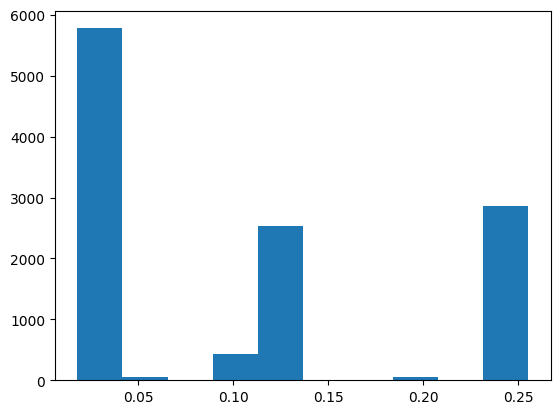

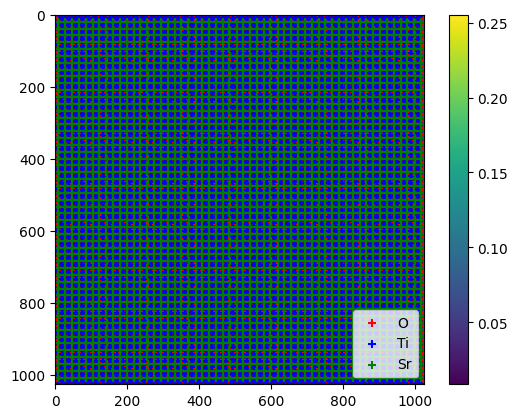

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

#Cargamos la imagen
Exp = np.load('Prueba_2.npy')

#Deconvolución
F = conv(Exp)

#Máximos locales
row_max, col_max = row_col_max_finder(F,0)

#Clasificación en subredes
col_row_a,col_row_b,col_row_c = subredes3(F,row_max,col_max)

dicion={}
dicion['lattice_img']=F
dicion['lattice_coord_a']=col_row_a
dicion['lattice_coord_b']=col_row_b
dicion['lattice_coord_c']=col_row_c
np.save("Prueba_ground_truth", dicion)

ground = np.load('Prueba_ground_truth.npy',allow_pickle=True)
images_train_b, images_test_all_b ,labels_all_b,labels_test_all_b =  train_prep3(ground,500,0.8)

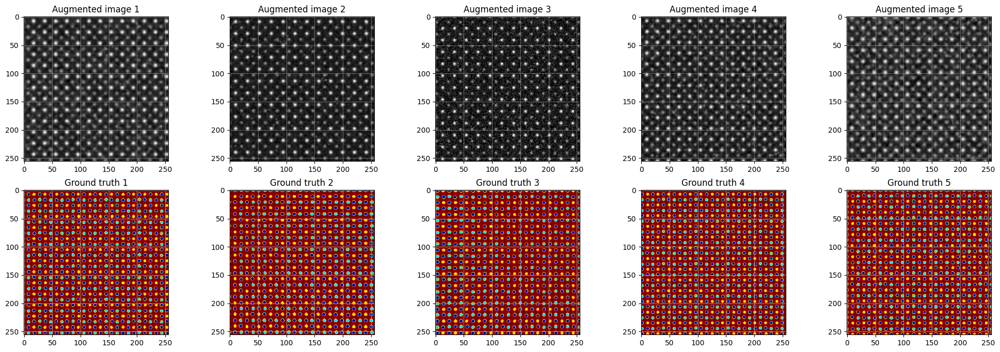

C:\Users\RedPC\anaconda3\lib\site-packages\atomai\trainers\trainer.py:653: UserWarning: No GPU found. The training can be EXTREMELY slow
  warnings.warn(


Epoch 1/300 ... Training loss: 1.4352 ... Test loss: 1.3116 ... Train Accuracy: 0.0433 ... Test Accuracy: 0.0289 ... GPU memory usage: N/A / N/A
Epoch 100/300 ... Training loss: 0.7049 ... Test loss: 0.5399 ... Train Accuracy: 0.5153 ... Test Accuracy: 0.5642 ... GPU memory usage: N/A / N/A
Epoch 200/300 ... Training loss: 0.405 ... Test loss: 0.3734 ... Train Accuracy: 0.5669 ... Test Accuracy: 0.592 ... GPU memory usage: N/A / N/A
Epoch 300/300 ... Training loss: 0.3268 ... Test loss: 0.3245 ... Train Accuracy: 0.5826 ... Test Accuracy: 0.5793 ... GPU memory usage: N/A / N/A
Model (final state) evaluation loss: 0.3295
Model (final state) IoU: 0.5757
Plotting training history


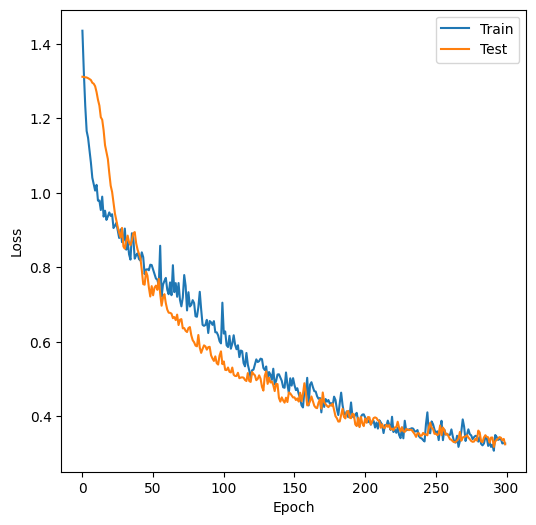

In [ ]:
import atomai as aoi
dataset = np.load('ground_truth.npz')
expdata = np.load('Prueba_2.npy')

images = dataset['X_train']
labels = dataset['y_train']
images_test = dataset['X_test']
labels_test = dataset['y_test']
n = 5  # number of images to plot

n = n + 1
fig = plt.figure(figsize=(30, 8))
for i in range(1, n):
    ax = fig.add_subplot(2, n, i)
    ax.imshow(images[i - 1, 0, :, :], cmap='gray')
    ax.set_title('Augmented image ' + str(i))
    ax.grid(alpha=0.5)
    ax = fig.add_subplot(2, n, i + n)
    ax.imshow(labels[i - 1, :, :], interpolation='Gaussian', cmap='jet')
    ax.set_title('Ground truth ' + str(i))
    ax.grid(alpha=0.75)
plt.show()
#Model training
model = aoi.models.Segmentor(nb_classes=4)
model.fit(images, labels,
            images_test,labels_test,  # training data
            training_cycles=300, compute_accuracy=True, swa=False  # training parameters
         )

In [ ]:
nn_output, coordinates = model.predict(expdata)

Batch 1/1
1 image was decoded in approximately 1.4821 seconds


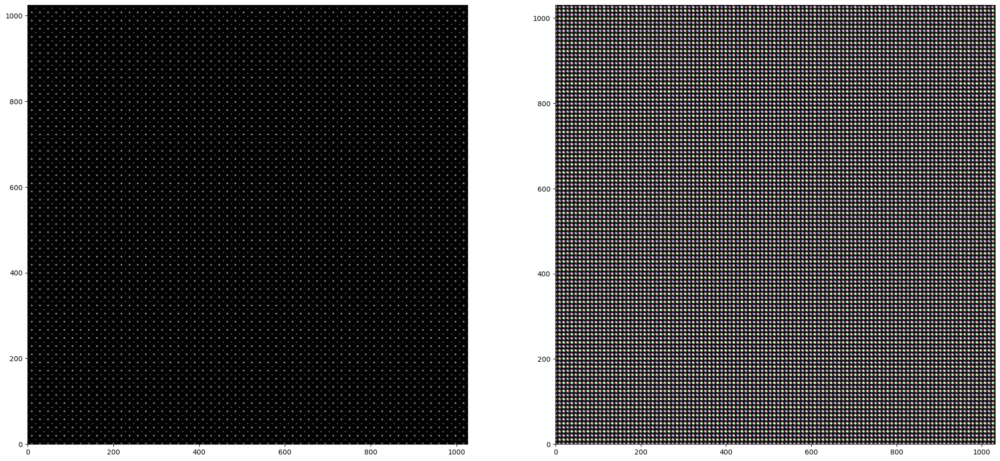

In [ ]:
_, (ax1, ax2) = plt.subplots(1, 2, figsize=(25, 12))
ax1.imshow(expdata, cmap='gray', origin="lower")
ax2.imshow(nn_output.squeeze() ,origin="lower")
plt.show()

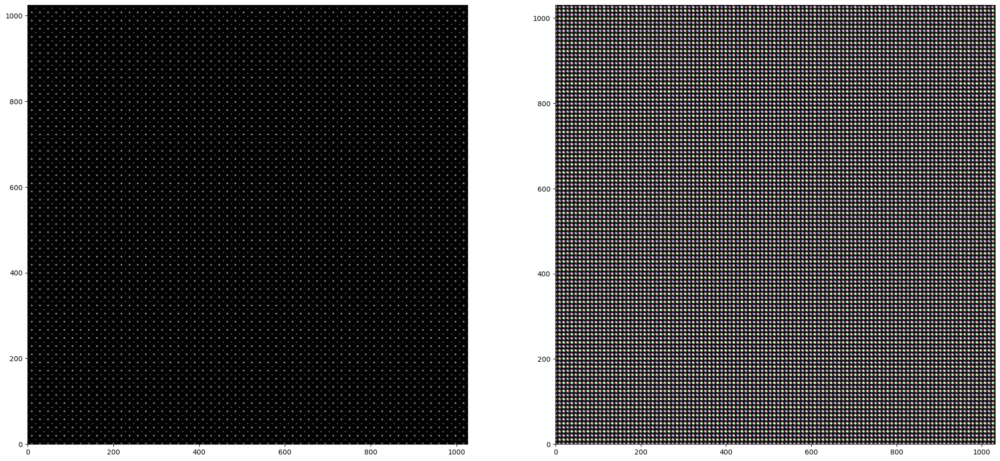

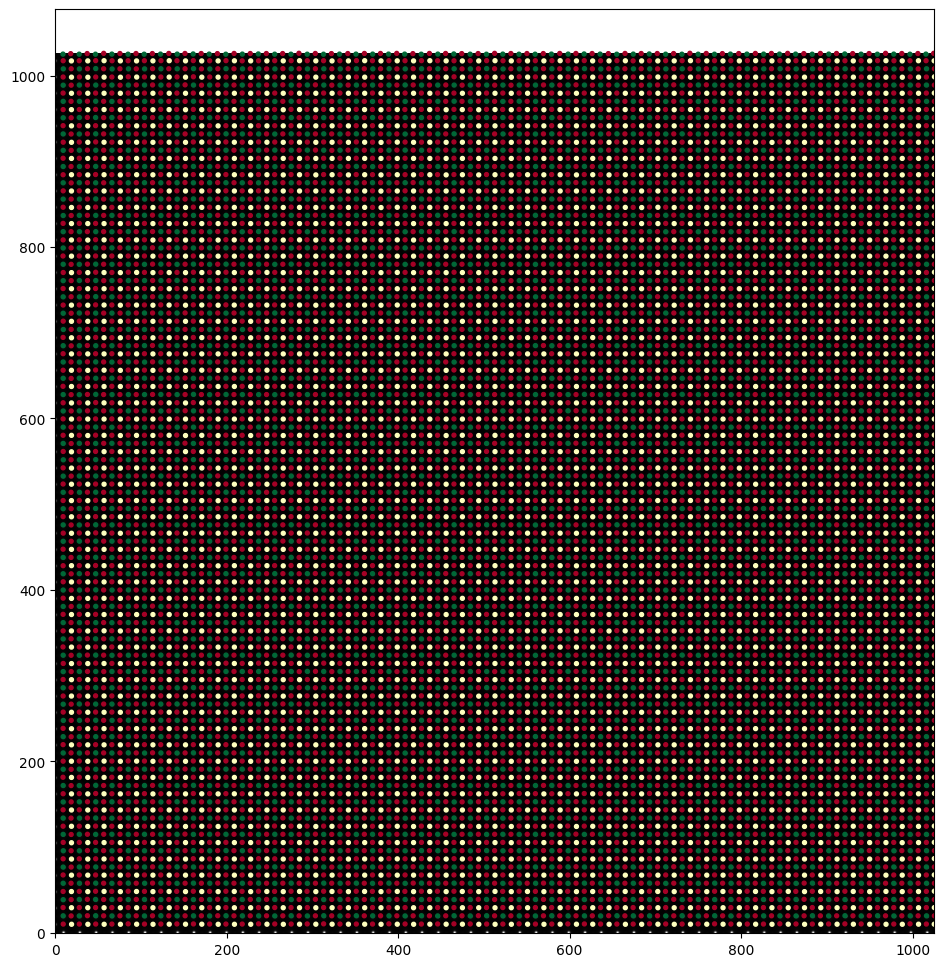

In [ ]:
    _, (ax1, ax2) = plt.subplots(1, 2, figsize=(25, 12))
    ax1.imshow(expdata, cmap='gray', origin="lower")
    ax2.imshow(nn_output.squeeze(), origin="lower")
    plt.show()
    aoi.utils.plot_coord(expdata, coordinates[0], fsize=12)

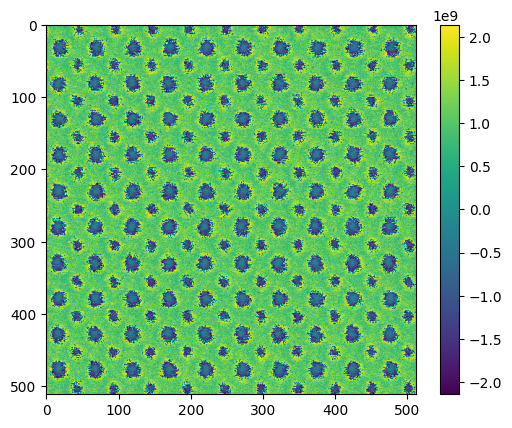

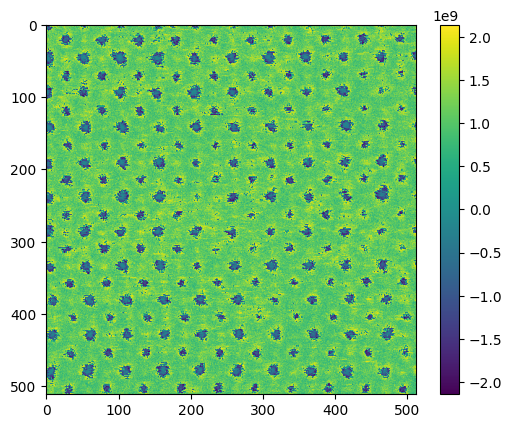

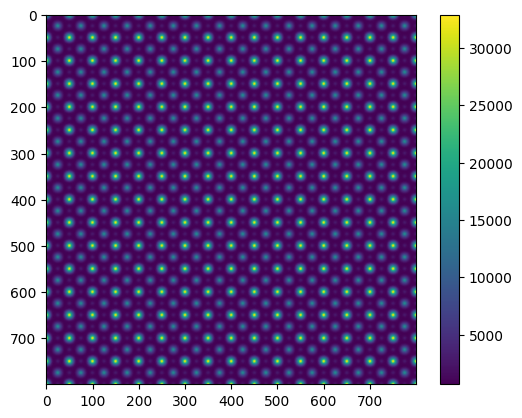

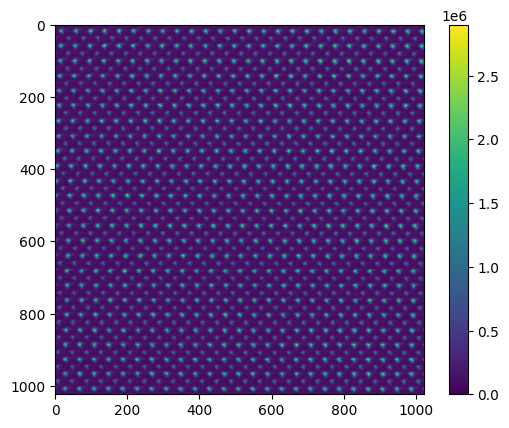

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import atomai as aoi
from PIL import Image

img1 = Image.open('Exp_1.tif')
graph1 = np.array(img1)
plt.imshow(graph1)
plt.colorbar()
plt.show()

img2 = Image.open('Exp_2.tif')
graph2 = np.array(img2)
plt.imshow(graph2)
plt.colorbar()
plt.show()

img3 = Image.open('Exp_3.tif')
graph3 = np.array(img3)
plt.imshow(graph3)
plt.colorbar()
plt.show()

img4 = Image.open('Exp_4.tif')
graph4 = np.array(img4)
plt.imshow(graph4)
plt.colorbar()
plt.show()

In [ ]:
nn_output1,coordinates1 = model.predict(graph1)

Batch 1/1
1 image was decoded in approximately 0.5535 seconds


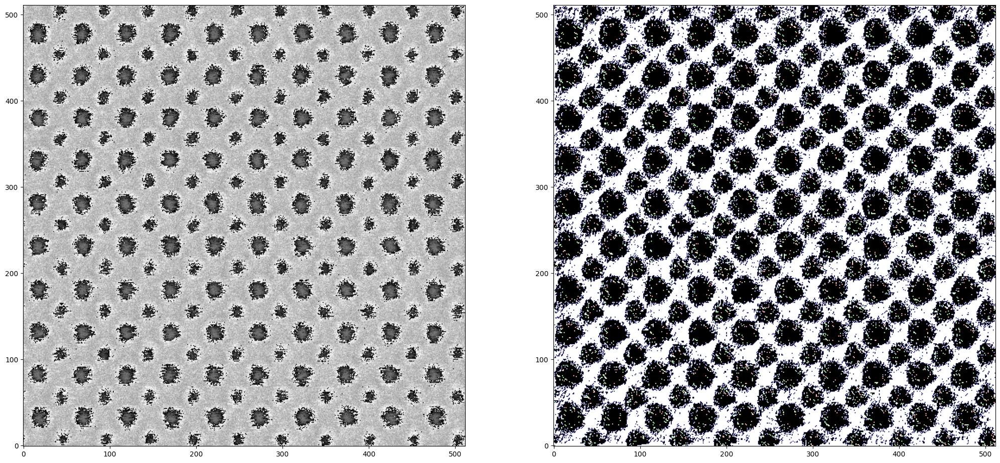

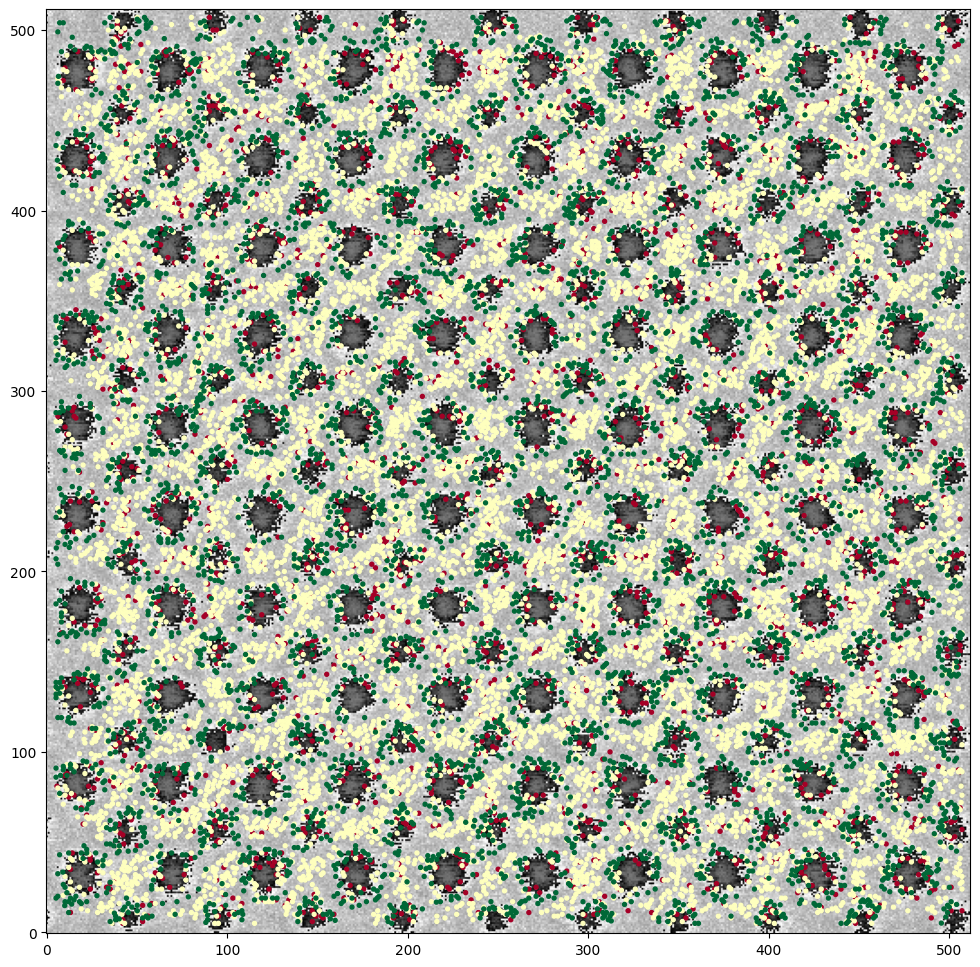

In [ ]:
    _, (ax1, ax2) = plt.subplots(1, 2, figsize=(25, 12))
    ax1.imshow(graph1, cmap='gray', origin="lower")
    ax2.imshow(nn_output1.squeeze(), origin="lower")
    plt.show()
    aoi.utils.plot_coord(graph1, coordinates1[0], fsize=12)

In [ ]:
nn_output2,coordinates2 = model.predict(graph2)

Batch 1/1
1 image was decoded in approximately 0.5266 seconds


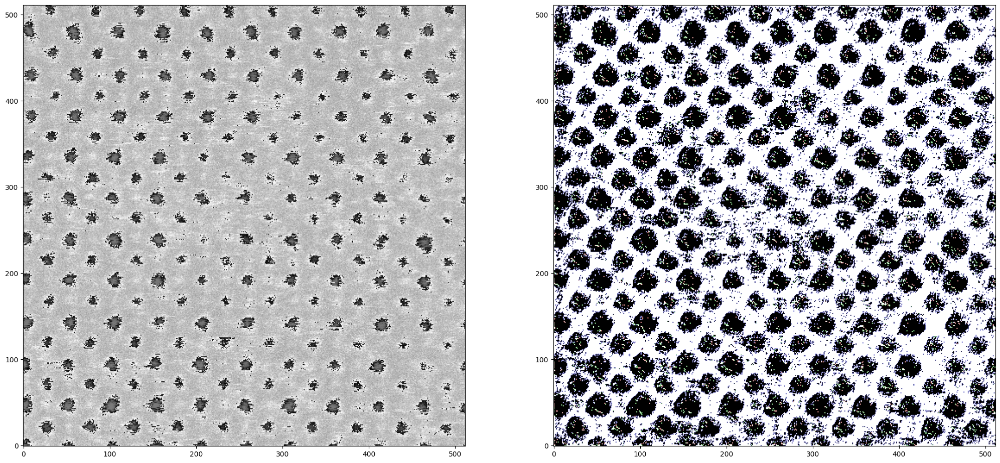

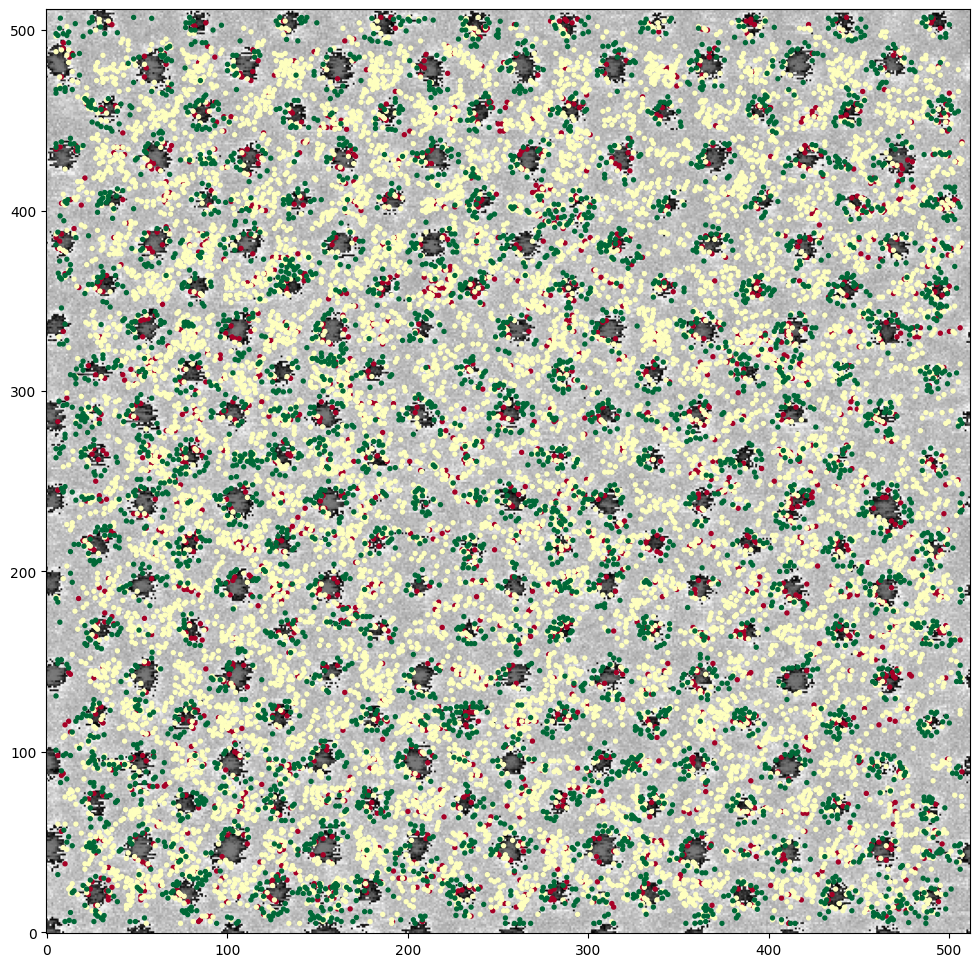

In [ ]:
    _, (ax1, ax2) = plt.subplots(1, 2, figsize=(25, 12))
    ax1.imshow(graph2, cmap='gray', origin="lower")
    ax2.imshow(nn_output2.squeeze(), origin="lower")
    plt.show()
    aoi.utils.plot_coord(graph2, coordinates2[0], fsize=12)

In [ ]:
nn_output3,coordinates3 = model.predict(graph3)

Batch 1/1
1 image was decoded in approximately 0.8507 seconds


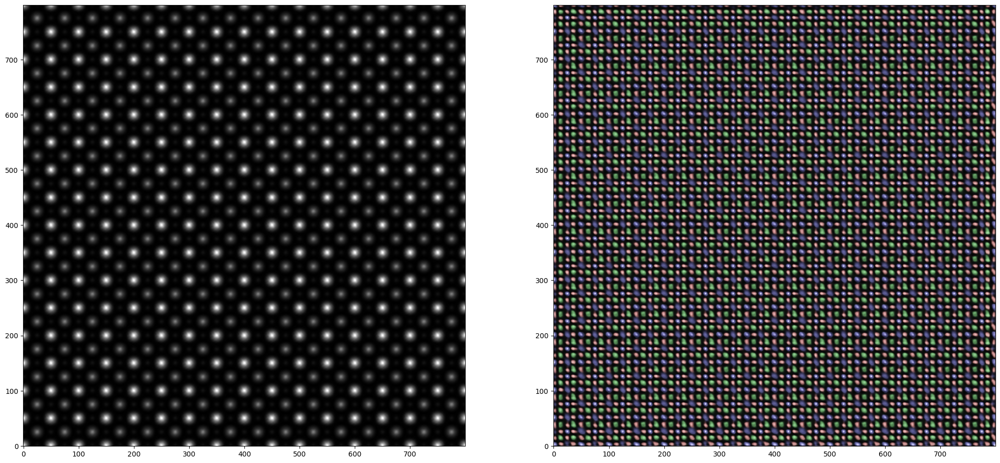

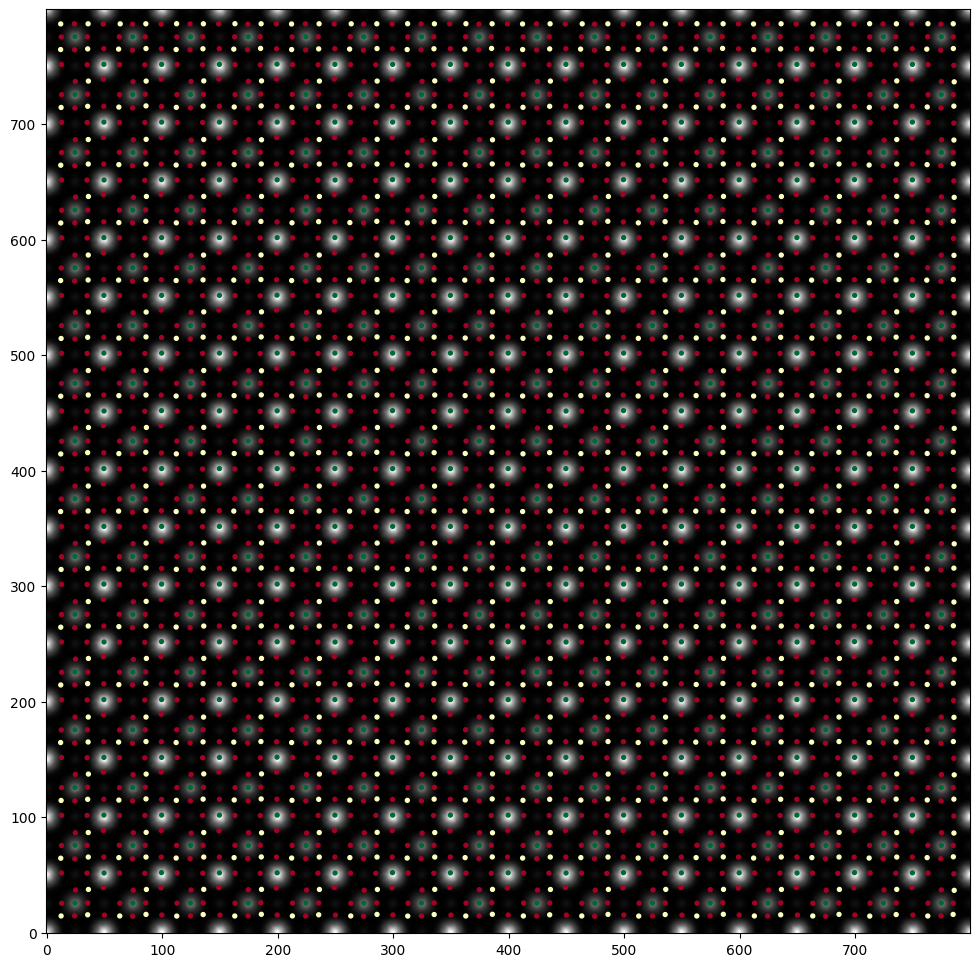

In [ ]:
    _, (ax1, ax2) = plt.subplots(1, 2, figsize=(25, 12))
    ax1.imshow(graph3, cmap='gray', origin="lower")
    ax2.imshow(nn_output3.squeeze(), origin="lower")
    plt.show()
    aoi.utils.plot_coord(graph3, coordinates3[0], fsize=12)

In [ ]:
nn_output4,coordinates4 = model.predict(graph4)

Batch 1/1
1 image was decoded in approximately 1.5354 seconds


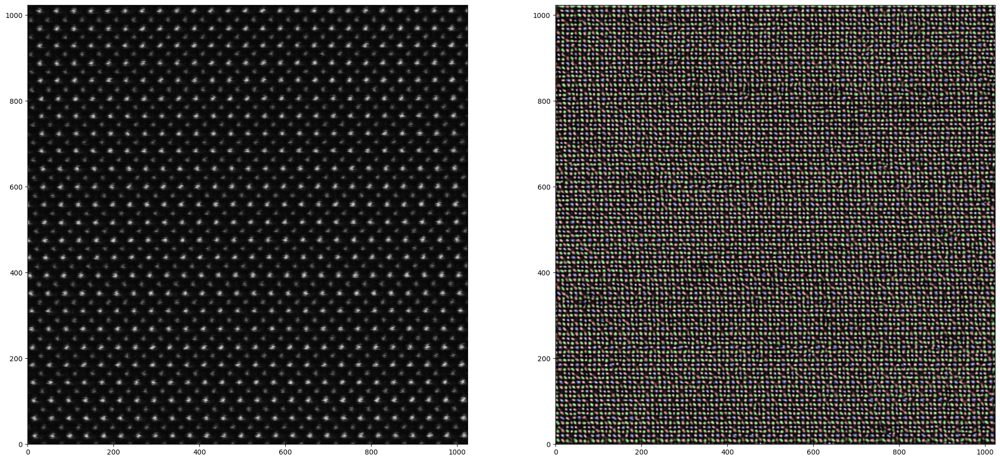

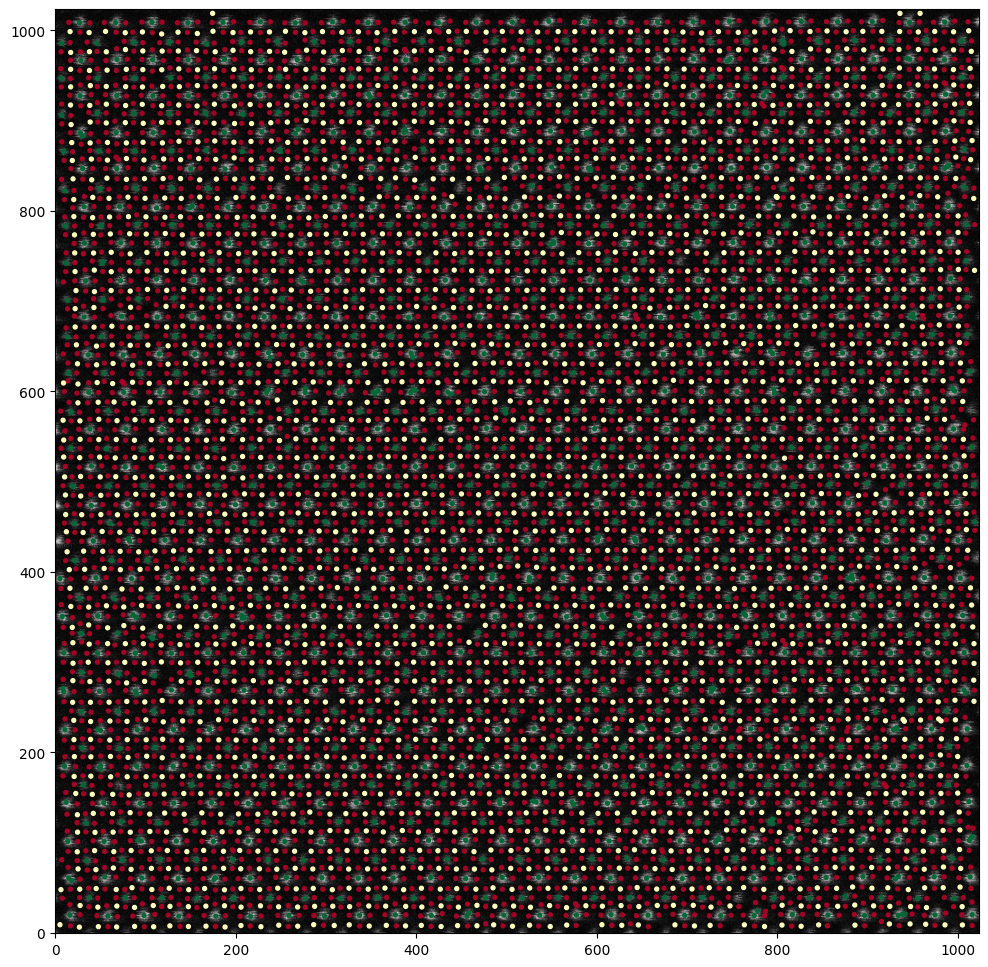

In [ ]:
    _, (ax1, ax2) = plt.subplots(1, 2, figsize=(25, 12))
    ax1.imshow(graph4, cmap='gray', origin="lower")
    ax2.imshow(nn_output4.squeeze(), origin="lower")
    plt.show()
    aoi.utils.plot_coord(graph4, coordinates4[0], fsize=12)